# This Review Sounds Positive!

## Goal:
### The goal of this Project is to build and critically analyse some supervised Machine Learning methods, to predict star ratings (1, 3, or 5) for reviews on restaurants.


## Acknowledgements

* The data has kindly been provided to us, under the provision that any resulting work should cite these two resources:
    * What Yelp fake review filter might be doing? A. Mukherjee, V. Venkataraman, B. Liu, and N. S. Glance, ICWSM, 2013.

    * Collective Opinion Spam Detection: Bridging Review Networks and Metadata. Shebuti Rayana, Leman Akoglu, ACM SIGKDD, Sydney, Australia, August 10-13, 2015


## Data description
* meta features: date, unique review ID, reviewer ID, business ID, votes cast by Yelp users (whether they think the review is funny, cool or useful)
* the original review text, provided as a single file with rows corresponding to the meta file
* text features: produced by various text encoding methods for review text
* class label: rating (3 possible levels, 1, 3 or 5)

# Importing relevant libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

## loading the data

In [2]:
review_meta_test = pd.read_csv('../input/review_meta_test.csv', index_col=False, delimiter = ',', header = 0)
review_meta_train = pd.read_csv('../input/review_meta_train.csv', index_col=False, delimiter = ',', header = 0)
review_text_test = pd.read_csv('../input/review_text_test.csv', index_col=False, delimiter = ',', header = 0)
review_text_train = pd.read_csv('../input/review_text_train.csv', index_col=False, delimiter = ',', header = 0)

In [3]:
print(review_meta_test.shape)
print(review_meta_train.shape)
print(review_text_test.shape)
print(review_text_train.shape)

(7018, 7)
(28068, 8)
(7018, 1)
(28068, 1)


In [4]:
review_meta_test

,date,review_id,reviewer_id,business_id,vote_funny,vote_cool,vote_useful
0,10/17/2011,WwAdD9wjkLqZHOO5,CY9iLsE2z_yLhLqJdD1WGw,cQnY_VneZisfUAqcbuEuKg,2,1,3
1,3/19/2007,Rd-Vra4drjDI8AQCXf6yTA,6feRQ3I9RpxRlEX7gPuJRg,sfWMOqUEp8S2adDeJp7Kzg,0,1,3
2,12/27/2008,mJD,RQs0smGxdXIlBqqlNP7pNg,2WoMT3wSpp9vxZeTv6u-cw,0,0,0
3,6/1/2010,J-xkladMPiVZFVhIbXLNEQ,q6EF83uL2lFRtnWwrfaYGA,AqgG-1aD6JYj9D6OmBWO3w,0,0,0
4,9/4/2012,jOMycoLCy79-256vNxl1kA,erZZ9K9wgdSswAm6TEh7Qw,boE4Ahsssqic7o5wQLI04w,0,0,0
...,...,...,...,...,...,...,...
7013,1/22/2010,QcCptbqQUgYwqeKz6Roncg,wISjGJS3bb6dh1rs2f1c1Q,jGiKIJCVLZHXQDSNnSLPsw,0,0,0
7014,6/14/2012,LG3FrYu03BCqQ-TAGsbowA,0eoCRbkKsEj8iv2Aow2ong,oEFJ29zAQaCNnQzebHQvpg,2,0,0
7015,5/10/2010,Y2IKY1Nbmt2rjbiVyJoSSg,eiMZGw1zY8xwk1Xc3GM8lw,jGiKIJCVLZHXQDSNnSLPsw,0,0,1
7016,6/9/2011,OrKMrbD8J2J-0jLPip6ifA,L80nu6pXxl07zb_IKn0ZLw,UQ3cGi3GdBljE3i2_qLcBQ,3,0,4


In [5]:
review_meta_train = review_meta_train.drop(['date', 'review_id', 'reviewer_id', 'business_id'], axis = 1)
review_meta_train

,vote_funny,vote_cool,vote_useful,rating
0,0,1,3,1
1,0,0,0,5
2,1,0,1,5
3,17,3,3,3
4,0,0,0,3
...,...,...,...,...
28063,0,0,0,1
28064,0,0,0,1
28065,0,0,5,5
28066,0,0,0,5


In [6]:
review_text_train

,review
0,dear longman & eagle.......you've left me no c...
1,Delish. The hubby and I wanted to do brunch on...
2,"yep, I've giving Yolk 5 stars. It's just reall..."
3,"Meat, meat, meat. It's meat-tastic. So much me..."
4,I caught up with the law school girls on a Sat...
...,...
28063,This afternoon I went to Yolk with my college ...
28064,Place has lots of side dishes. But that's abou...
28065,I am a huge fan of Brazillian steakhouses I've...
28066,Great Brunch.\n


In [7]:
df_train = review_meta_train.copy()
df_train['review'] = review_text_train.copy()
df_train

df_test = review_text_test.copy()
df_test['vote_funny'] = review_meta_test.vote_funny
df_test['vote_cool'] = review_meta_test.vote_funny
df_test['vote_useful'] = review_meta_test.vote_funny
df_test

,review,vote_funny,vote_cool,vote_useful
0,It is 10am on a Monday morning and my wife say...,2,2,2
1,I came here with a friend for her work thing -...,0,0,0
2,ATTENTION!!! DO NOT GO TO THIS RESTAURANT EVER...,0,0,0
3,"I agree, with Jonathan S. - this place is a 3....",0,0,0
4,"First visit to Chicago, and a friend recommend...",0,0,0
...,...,...,...,...
7013,I LOVED XOCO! It was amazing! My friends and I...,0,0,0
7014,Place is pretty dark. A place to chat with a g...,2,2,2
7015,Get to Xoco and you can order yourself a tasty...,0,0,0
7016,I'm writing this less than 10 minutes after re...,3,3,3


In [8]:
df_train.columns.values

array(['vote_funny', 'vote_cool', 'vote_useful', 'rating', 'review'],
      dtype=object)

In [9]:
cols = ['review','vote_funny', 'vote_cool', 'vote_useful', 'rating']
df_train= df_train[cols]
df_train

,review,vote_funny,vote_cool,vote_useful,rating
0,dear longman & eagle.......you've left me no c...,0,1,3,1
1,Delish. The hubby and I wanted to do brunch on...,0,0,0,5
2,"yep, I've giving Yolk 5 stars. It's just reall...",1,0,1,5
3,"Meat, meat, meat. It's meat-tastic. So much me...",17,3,3,3
4,I caught up with the law school girls on a Sat...,0,0,0,3
...,...,...,...,...,...
28063,This afternoon I went to Yolk with my college ...,0,0,0,1
28064,Place has lots of side dishes. But that's abou...,0,0,0,1
28065,I am a huge fan of Brazillian steakhouses I've...,0,0,5,5
28066,Great Brunch.\n,0,0,0,5


In [10]:
df_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7018 entries, 0 to 7017
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   review       7018 non-null   object
 1   vote_funny   7018 non-null   int64 
 2   vote_cool    7018 non-null   int64 
 3   vote_useful  7018 non-null   int64 
dtypes: int64(3), object(1)
memory usage: 219.4+ KB


In [11]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28068 entries, 0 to 28067
Data columns (total 5 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   review       28068 non-null  object
 1   vote_funny   28068 non-null  int64 
 2   vote_cool    28068 non-null  int64 
 3   vote_useful  28068 non-null  int64 
 4   rating       28068 non-null  int64 
dtypes: int64(4), object(1)
memory usage: 1.1+ MB


# Preprocessing data

In [12]:
df_train.review

0        dear longman & eagle.......you've left me no c...
1        Delish. The hubby and I wanted to do brunch on...
2        yep, I've giving Yolk 5 stars. It's just reall...
3        Meat, meat, meat. It's meat-tastic. So much me...
4        I caught up with the law school girls on a Sat...
                               ...                        
28063    This afternoon I went to Yolk with my college ...
28064    Place has lots of side dishes. But that's abou...
28065    I am a huge fan of Brazillian steakhouses I've...
28066                                      Great Brunch.\n
28067    I love The Chicago Diner. I first came here ab...
Name: review, Length: 28068, dtype: object

# Cleaning the text data 
## i.e. removing special characters, alpha numeric characters and symbols

In [13]:
import re
import string

### cleaning text round 1

In [14]:
def clean_round_1(text):
    text = text.lower()
    text = re.sub('[%s]' % re.escape(string.punctuation), '', text)
    text = re.sub('\w*\d\w*', '', text)
    return text
round_1 = lambda x: clean_round_1(x)

In [15]:
data_review_cleaned = pd.DataFrame(df_train.review.apply(round_1))
data_review_cleaned

,review
0,dear longman eagleyouve left me no choice the...
1,delish the hubby and i wanted to do brunch on ...
2,yep ive giving yolk stars its just really tha...
3,meat meat meat its meattastic so much meat in ...
4,i caught up with the law school girls on a sat...
...,...
28063,this afternoon i went to yolk with my college ...
28064,place has lots of side dishes but thats about ...
28065,i am a huge fan of brazillian steakhouses ive ...
28066,great brunch\n


### cleaning text round 2

In [16]:
def clean_round_2(text):
    text = re.sub('\n', '', text)
    text = re.sub('["..._.,;?!*()-:]', '', text)
    return text
round_2 = lambda x: clean_round_2(x)

In [17]:
data_review_cleaned = pd.DataFrame(df_train.review.apply(round_2))
data_review_cleaned

,review
0,dear longman & eagleyou've left me no choice T...
1,Delish The hubby and I wanted to do brunch on ...
2,yep I've giving Yolk stars It's just really t...
3,Meat meat meat It's meattastic So much meat In...
4,I caught up with the law school girls on a Sat...
...,...
28063,This afternoon I went to Yolk with my college ...
28064,Place has lots of side dishes But that's about...
28065,I am a huge fan of Brazillian steakhouses I've...
28066,Great Brunch


## Creating corpus for feature extraction

In [18]:
rev_string=" "
for i in range(len(data_review_cleaned)):
    rev_string += data_review_cleaned['review'][i] + " "
rev_string

" dear longman & eagleyou've left me no choice The ideas and menu looks and reads exceptionally I WANT to eat everything on the menu but over the multiple times that i've been there not just one or two but many the only consistent thing you do is serve overpriced crap Went in one night and spent $ on an over cooked piece of venison went in another got UNDERcooked sweetbreads Actually attempted dessert one night and the donuts tasted like three weeks of unchanged fryer oil not to mention they tasted like friesnot donuts Ordered the Tartar the other nightoh my god You could smell it when it hit the table Ground beef REALLY Thats what you get preportioned two days before brown and wreaks I'm glad they have a great whiskey list because getting shit faced was the only way i got through the LAST meal i'll ever eat at longman Thanks for a memorable anniversary Delish The hubby and I wanted to do brunch on Sunday and when I thought of Longman & Eagle it showed that it was closed We decided to 

In [19]:
from sklearn.feature_extraction.text import CountVectorizer

cv = CountVectorizer(stop_words = 'english')
data_cv = cv.fit_transform(data_review_cleaned.review)
data_dtm= pd.DataFrame(data_cv.toarray(), columns = cv.get_feature_names())
data_dtm.index = data_review_cleaned.index
data_dtm

,aa,aaa,aaaaaaaaaaaaaa,aaaaaaaaaaaaaand,aaaaaaaaaaaah,aaaaaaaaaggggh,aaaaaaahh,aaaaaawesome,aaaaahhh,aaaaahhhh,...,zukes,zulbia,zuni,zuppa,zuppe,zweigeit,zweigelt,zza,zzo,zzz
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28063,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
28064,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
28065,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
28066,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


### creating and displaying transpose Document Term Matrix (only for visualization)

In [20]:
data_dtm_transposed = data_dtm.T
data_dtm_transposed

,0,1,2,3,4,5,6,7,8,9,...,28058,28059,28060,28061,28062,28063,28064,28065,28066,28067
aa,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
aaa,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
aaaaaaaaaaaaaa,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
aaaaaaaaaaaaaand,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
aaaaaaaaaaaah,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
zweigeit,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
zweigelt,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
zza,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
zzo,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [21]:
df_test.review

0       It is 10am on a Monday morning and my wife say...
1       I came here with a friend for her work thing -...
2       ATTENTION!!! DO NOT GO TO THIS RESTAURANT EVER...
3       I agree, with Jonathan S. - this place is a 3....
4       First visit to Chicago, and a friend recommend...
                              ...                        
7013    I LOVED XOCO! It was amazing! My friends and I...
7014    Place is pretty dark. A place to chat with a g...
7015    Get to Xoco and you can order yourself a tasty...
7016    I'm writing this less than 10 minutes after re...
7017    I love how this gem is hidden. I felt like Ali...
Name: review, Length: 7018, dtype: object

In [22]:
data_review_cleaned_test = pd.DataFrame(df_test.review.apply(round_1))
data_review_cleaned_test = pd.DataFrame(df_test.review.apply(round_2))
data_review_cleaned_test

,review
0,It is am on a Monday morning and my wife says ...
1,I came here with a friend for her work thing ...
2,ATTENTION DO NOT GO TO THIS RESTAURANT EVER AG...
3,I agree with Jonathan S this place is a if i...
4,First visit to Chicago and a friend recommende...
...,...
7013,I LOVED XOCO It was amazing My friends and I w...
7014,Place is pretty dark A place to chat with a gr...
7015,Get to Xoco and you can order yourself a tasty...
7016,I'm writing this less than minutes after retu...


# Exploratory Data Analysis(EDA)

In [23]:
frequency_words = {}
for j in data_dtm_transposed.columns:
    frequency = data_dtm_transposed[j].sort_values(ascending = False).head(50)
    frequency_words[j] = list(zip(frequency.index, frequency.values))


In [24]:
data = data_dtm_transposed

In [25]:
from collections import Counter

words = []
for user_id in data.columns:
    frequency = [word for (word,count) in frequency_words[user_id]]
    for f in frequency:
        words.append(f)

In [26]:
common_words_count = Counter(words).most_common()

In [27]:
df_common_words = pd.DataFrame(common_words_count, columns = ['word', 'count'])
df_common_words

,word,count
0,flourless,13307
1,floursee,13253
2,flourishes,13207
3,floury,13137
4,flourished,12985
...,...,...
43977,suri,1
43978,fooling,1
43979,poorest,1
43980,churracarias,1


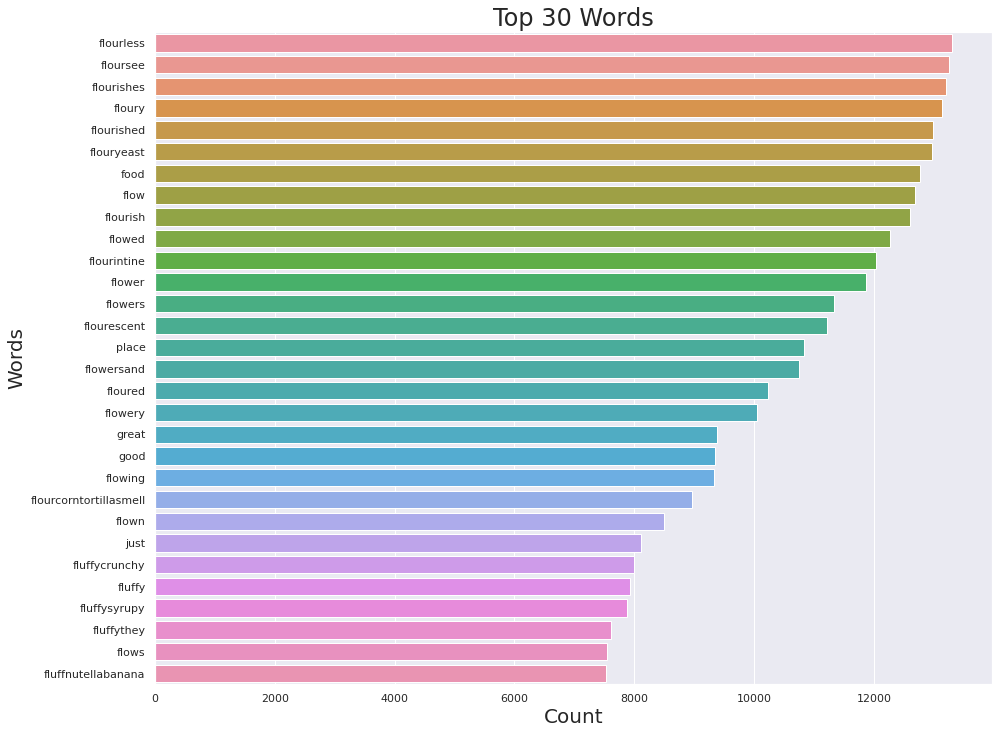

In [28]:
fig, ax = plt.subplots()
fig.set_size_inches(15, 12)
ax = sns.barplot(x='count', y='word', data=df_common_words[:30])
ax.set_title('Top 30 Words', size = 24)
ax.set_xlabel('Count', size = 20)
ax.set_ylabel('Words', size = 20)

fig.savefig('top_30_words.png')

## Word Cloud

In [29]:
from wordcloud import WordCloud
from sklearn.feature_extraction import text
# from sklearn.feature_extraction import CountVectorizer

In [30]:
stop_words = text.ENGLISH_STOP_WORDS

wc = WordCloud(width = 800, height= 400, stopwords= stop_words, background_color = 'white', colormap = 'Dark2', max_font_size = 170, random_state = 45)

data_for_wc = pd.DataFrame()
data_for_wc['review'] = data_review_cleaned['review']
data_for_wc = data_for_wc.reset_index(drop = True)

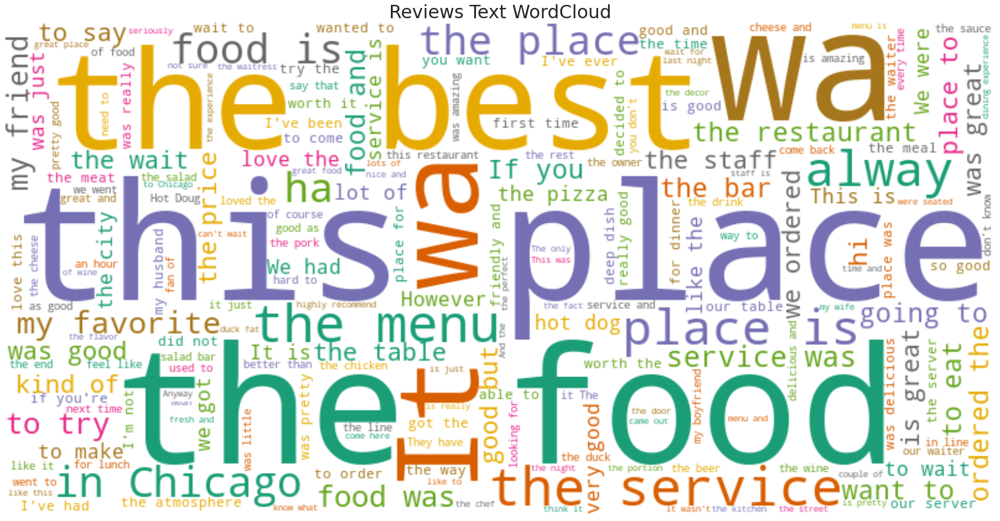

In [31]:
text_wc = ''
for i in range(len(data_for_wc)):
    text_wc += data_for_wc['review'][i]
    
cloud = wc.generate(text_wc)
plt.figure(figsize=(30, 15))
plt.title('Reviews Text WordCloud', fontsize = 30)
plt.imshow(wc, interpolation = 'bilinear')
plt.axis('off')

cloud.to_file('word_cloud.png')

# Sentiment Analysis


In [32]:
df_train['review'] = data_review_cleaned['review']
df_train

,review,vote_funny,vote_cool,vote_useful,rating
0,dear longman & eagleyou've left me no choice T...,0,1,3,1
1,Delish The hubby and I wanted to do brunch on ...,0,0,0,5
2,yep I've giving Yolk stars It's just really t...,1,0,1,5
3,Meat meat meat It's meattastic So much meat In...,17,3,3,3
4,I caught up with the law school girls on a Sat...,0,0,0,3
...,...,...,...,...,...
28063,This afternoon I went to Yolk with my college ...,0,0,0,1
28064,Place has lots of side dishes But that's about...,0,0,0,1
28065,I am a huge fan of Brazillian steakhouses I've...,0,0,5,5
28066,Great Brunch,0,0,0,5


In [33]:
data = df_train

In [34]:
from textblob import TextBlob

In [35]:
pol = lambda x: TextBlob(x).sentiment.polarity
sub = lambda x: TextBlob(x).sentiment.subjectivity

data['polarity'] = data['review'].apply(pol)
data['subjectivity'] = data['review'].apply(sub)

### plotting Polarity V/S Subjective and mapping them with respect to the 'rating'

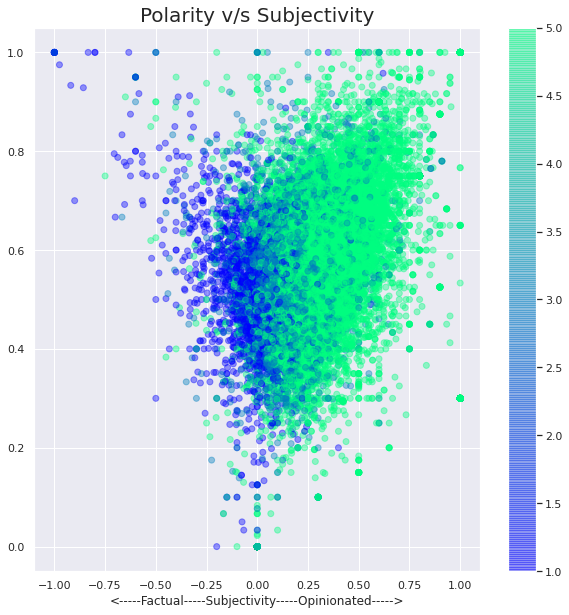

In [36]:
plt.figure(figsize = (10, 10))
scatter = plt.scatter(data['polarity'], data['subjectivity'], c= data['rating'], cmap= 'winter', alpha = 0.4)
plt.xlabel('<-----Negative-----Polarity-----Positive----->')
plt.xlabel('<-----Factual-----Subjectivity-----Opinionated----->')
plt.title('Polarity v/s Subjectivity', size = 20)
plt.colorbar()
plt.show

plt.savefig('polarity_vs_subjectivity_sentiment', dpi = 150)

### sometimes there maybe a chance where a review is based on an opinion and not on a fact. Hence, we will take subjectivity sentiment to classify reviews on the bases of factual and opinionated sentiments.

## Visualizing Positive V/S Negative reviews

In [37]:
positive_values = 0
negative_values = 0

for i in range(len(data['polarity'])):
    if data['polarity'][i] < 0.5:
        negative_values += 1
    else:
        positive_values += 1

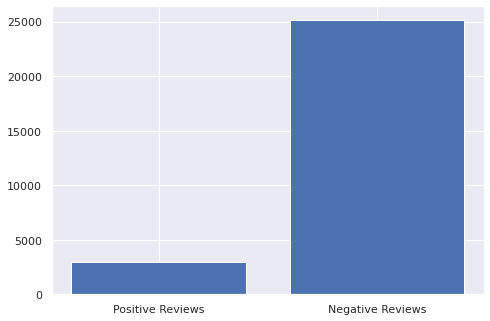

<Figure size 432x288 with 0 Axes>

In [38]:
fig = plt.figure()
ax = fig.add_axes([0,0,1,1])
polarity_prop = ['Positive Reviews', 'Negative Reviews']
polarity_vals = [positive_values, negative_values]
ax.bar(polarity_prop, polarity_vals)
plt.show()

plt.savefig('Positive_vs_Negative_reviews.png', dpi = 150)

## Visualizing Factual V/S Opinionated Reviews

In [39]:
factual_values = 0
opinionated_values = 0

for i in range(len(data['subjectivity'])):
    if data['subjectivity'][i]<0.5:
        factual_values += 1
    else:
        opinionated_values += 1

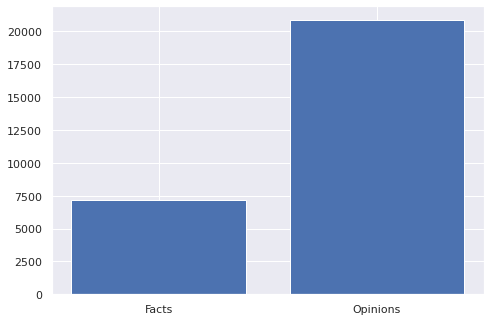

<Figure size 432x288 with 0 Axes>

In [40]:
fig = plt.figure()
ax = fig.add_axes([0,0,1,1])
subjectivity_prop = ['Facts', 'Opinions']
subjectivity_vals = [factual_values, opinionated_values]
ax.bar(subjectivity_prop, subjectivity_vals)
plt.show()

plt.savefig('factual_vs_opinionated.png', dpi = 150)

### Visualizing correlation between features

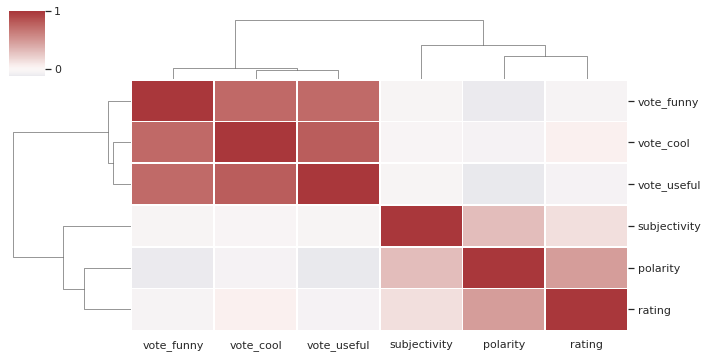

In [41]:
cor = df_train.loc[:,["vote_funny", "vote_cool", "vote_useful", "polarity", "subjectivity", "rating"]]
correlation_map = sns.clustermap(cor.corr(), center=0, cmap="vlag", linewidths= .75, figsize= (10, 5))
correlation_map.savefig('feature_correlation.png', dpi = 150)

## Extracting sentiments for test data

In [42]:
from textblob import TextBlob

In [43]:
pol_test = lambda x: TextBlob(x).sentiment.polarity
sub_test = lambda x: TextBlob(x).sentiment.subjectivity

df_test['polarity'] = df_test.review.apply(pol_test)
df_test['subjectivity'] = df_test.review.apply(sub_test)

df_test

,review,vote_funny,vote_cool,vote_useful,polarity,subjectivity
0,It is 10am on a Monday morning and my wife say...,2,2,2,0.129069,0.464558
1,I came here with a friend for her work thing -...,0,0,0,0.375325,0.605844
2,ATTENTION!!! DO NOT GO TO THIS RESTAURANT EVER...,0,0,0,-0.032619,0.598452
3,"I agree, with Jonathan S. - this place is a 3....",0,0,0,0.210748,0.511455
4,"First visit to Chicago, and a friend recommend...",0,0,0,0.264236,0.459028
...,...,...,...,...,...,...
7013,I LOVED XOCO! It was amazing! My friends and I...,0,0,0,0.324303,0.567911
7014,Place is pretty dark. A place to chat with a g...,2,2,2,0.285000,0.700000
7015,Get to Xoco and you can order yourself a tasty...,0,0,0,0.076175,0.454397
7016,I'm writing this less than 10 minutes after re...,3,3,3,0.196914,0.536697


# Predictive Modelling

# Logistic Regression Model

In [44]:
targets = df_train['rating']
inputs = df_train.drop(['review', 'rating'], axis = 1)

In [45]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(inputs, targets, test_size = 0.1, random_state = 365)

### Visualing Distribution of Features V/S Target
#### To determine the relevance of the logictic regression model

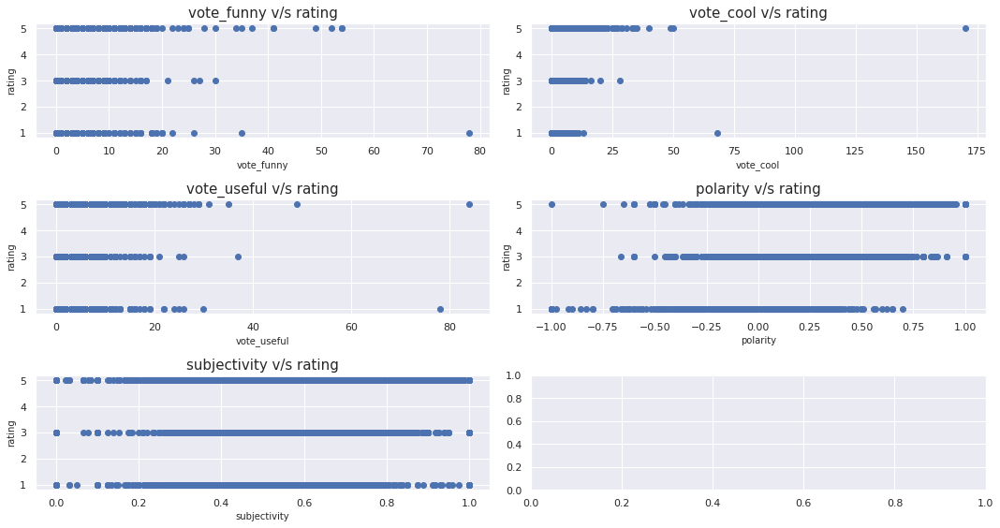

In [46]:
fig, axes = plt.subplots(nrows = 3, ncols = 2)
fig.set_figheight(8)
fig.set_figwidth(15)

axes[0,0].scatter(inputs['vote_funny'], targets)
axes[0,0].set_title('vote_funny v/s rating', size =15)
axes[0,0].set_xlabel('vote_funny', size = 10)
axes[0,0].set_ylabel('rating', size =10)

axes[0,1].scatter(inputs['vote_cool'], targets)
axes[0,1].set_title('vote_cool v/s rating', size =15)
axes[0,1].set_xlabel('vote_cool', size = 10)
axes[0,1].set_ylabel('rating', size =10)

axes[1,0].scatter(inputs['vote_useful'], targets)
axes[1,0].set_title('vote_useful v/s rating', size =15)
axes[1,0].set_xlabel('vote_useful', size = 10)
axes[1,0].set_ylabel('rating', size =10)

axes[1,1].scatter(inputs['polarity'], targets)
axes[1,1].set_title('polarity v/s rating', size =15)
axes[1,1].set_xlabel('polarity', size = 10)
axes[1,1].set_ylabel('rating', size =10)

axes[2,0].scatter(inputs['subjectivity'], targets)
axes[2,0].set_title('subjectivity v/s rating', size =15)
axes[2,0].set_xlabel('subjectivity', size = 10)
axes[2,0].set_ylabel('rating', size =10)

fig.tight_layout()

plt.savefig('logistic_regression_data_distribution_scatter_plots.png', dpi = 150)

In [47]:
from sklearn.linear_model import LogisticRegression
from sklearn import metrics
%matplotlib inline
import warnings
warnings.filterwarnings('ignore')

In [48]:
log_reg = LogisticRegression()
log_results = log_reg.fit(x_train, y_train)

In [49]:
y_pred = log_reg.predict(x_test)

### logictic model evaluation: Confusion Matrix

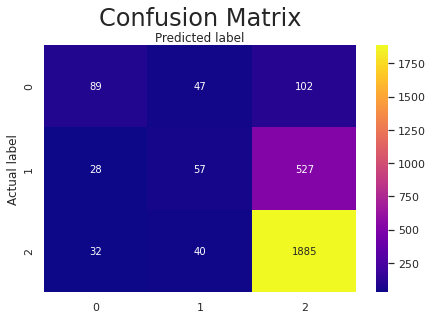

In [50]:
cnf_matrix = metrics.confusion_matrix(y_test, y_pred)
class_names = [1,3,5]
fig, ax = plt.subplots()
tick_marks = np.arange(2)
plt.xticks(tick_marks, class_names)
plt.yticks(tick_marks, class_names)
sns.heatmap(pd.DataFrame(cnf_matrix), annot= True, cmap = "plasma", fmt = 'g')
ax.xaxis.set_label_position("top")
plt.tight_layout()
plt.title('Confusion Matrix', y=1.1, size = 24)
plt.xlabel('Predicted label')
plt.ylabel('Actual label')

fig.savefig('logistic_regression_confusion_matrix.png', dpi = 150)

#### Accuracy of logictic regression

In [51]:
print('Accuracy: '+str((metrics.accuracy_score(y_test, y_pred)*100).round(3))+'%')

Accuracy: 72.355%


## Making predictions on the test_df dataset and saving in a .csv file

In [52]:
y_pred_logistic_regression = log_reg.predict(df_test.drop(['review'], axis = 1))

In [53]:
predictions = pd.DataFrame()
instance_id = []
for i in range(len(df_test.review)):
    instance_id.append(i+1)

predictions['Instance_id'] = instance_id
predictions['rating'] = y_pred_logistic_regression

In [54]:
pd.DataFrame(predictions).to_csv("logistic_regression_predictions.csv")

# KNN Classifier


### Defining KNN Classifier with 103 neighbours

In [55]:
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier(n_neighbors = 103)
knn.fit(x_train, y_train)
y_pred = knn.predict(x_test)

#### Accuracy of KNN model

In [56]:
from sklearn import metrics

print("Accuracy:"+ str((metrics.accuracy_score(y_test, y_pred)*100).round(3))+'%')

Accuracy:72.818%


## Making predictions on the test_df dataset and saving in a .csv file

In [57]:
y_pred_KNN_predictions = knn.predict(df_test.drop(['review'],axis = 1))

predictions = pd.DataFrame()
instance_id = []
for i in range(len(df_test.review)):
    instance_id.append(i+1)

predictions['Instance_id'] = instance_id
predictions['rating'] = y_pred_KNN_predictions

pd.DataFrame(predictions).to_csv("KNN_predictions.csv")

# Naive Bayes

### Gaussian Naive Bayes

In [58]:
from sklearn.naive_bayes import GaussianNB
model_gnb = GaussianNB()
model_gnb.fit(x_train, y_train)

pred_gnb = model_gnb.predict(x_test)

acc_gnb = model_gnb.score(x_test, y_test)

print("Accuracy (Gaussian Naive Bayes) = " + str((acc_gnb * 100).round(3))+ '%')

Accuracy (Gaussian Naive Bayes) = 62.487%


### Multinomial Naive Bayes

In [59]:
from sklearn.naive_bayes import MultinomialNB
model_mnb = MultinomialNB()
model_mnb.fit(x_train.drop(['polarity'],axis = 1), y_train)

acc_mnb = model_mnb.score(x_test.drop(['polarity'],axis = 1), y_test)

print("Accuracy (Multinomial Naive Bayes) = " + str((acc_mnb * 100).round(3))+ '%')

Accuracy (Multinomial Naive Bayes) = 70.004%


### Bernoulli Naive Bayes

In [60]:
from sklearn.naive_bayes import BernoulliNB
from sklearn import metrics
from sklearn.metrics import accuracy_score

model_bnb = BernoulliNB(binarize = False)
model_bnb.fit(x_train, y_train)

y_expected = y_test
y_pred = model_bnb.predict(x_test)

print("Accuracy (Bernoulli Naive Bayes) = " + str((accuracy_score(y_expected, y_pred) * 100).round(3))+ '%')

Accuracy (Bernoulli Naive Bayes) = 71.286%


In [61]:
y_pred = model_bnb.predict(df_test.drop(['review'], axis =1))

predictions = pd.DataFrame()
instance_id = []
for i in range(len(df_test.review)):
    instance_id.append(i+1)

predictions['Instance_id'] = instance_id
predictions['rating'] = y_pred

pd.DataFrame(predictions).to_csv("Bernoulli_Naive_Bayes_Predictions.csv")

# Support Vector Machine (kernel = Linear) 
## NOT INCLUDED IN THE REPORT DUE TO EXCESS WORD COUNT

In [62]:
from sklearn import svm

clf = svm.SVC(kernel='linear')
clf.fit(x_train, y_train)

y_pred = clf.predict(x_test)

#printing the accuracy of SVM
print("Accuracy:", str(((metrics.accuracy_score(y_test, y_pred))*100).round(3))+'%')

Accuracy: 72.355%


## Making predictions on the test_df dataset and saving in a .csv file

In [63]:
y_pred_svm = clf.predict(df_test.drop(['review'], axis = 1))

predictions = pd.DataFrame()
instance_id = []
for i in range(len(df_test.review)):
    instance_id.append(i+1)

predictions['Instance_id'] = instance_id
predictions['rating'] = y_pred_svm

pd.DataFrame(predictions).to_csv("SVM_predictions.csv")

# Conclusion:
## The KNN model had the best accuracy that was 72.818% making it the ideal model for this problem.